# Project 5. Image Denoising

## Introdcution

Photos can record moments of life, but we can't always get satisfactory photos. For example, a photo with a lot of noise will affect the clarity of the real scene.

Typically the term **“image noise”** is used to refer to noise in 2D images, not 3D images. The original meaning of "noise" was "unwanted signal"; unwanted electrical fluctuations in signals received by AM radios caused audible acoustic noise ("static"). By analogy, unwanted electrical fluctuations are also called "noise".

There are various distributions of image noise. We will talk about the *salt and pepper noise* in the following. Only grayscale (black and white) photos exhibit salt and pepper noise, which causes certain randomly selected pixels to change from their original color to either white or black. In other words, an image with salt and pepper noise will contain some dark pixels in some bright areas and some bright pixels in some dark areas.

In this project, we will explore and test two distinct filters to decrease salt and pepper noise in black and white photographs. The *mean filter* and the *median filter* are the two filtering tools we are going to test.

## Part 1. Add Salt and Pepper Noise

Import the packages we need for this project.

In [1]:
import numpy as np
import matplotlib.pyplot as plt

The code below defines a function that adds *salt and pepper noise* in a percentage of pixels to an input image. The function with two arguments `img` and `noise` is called `sp.noise`. It generates two `boolean masks` based on the value of `noise` and uses them to add noise to the image `img`. 

The input image is first converted to grayscale. Then two boolean masks are generated using a random threshold value. These masks are used to add pepper noise and salt noise to the image by setting the values of the image array to $0$ or $1$ at the positions where the masks are True. Finally, the function returns the noisy image. If `noise=0.5`, then there are $25\%$ of salt and $25\%$ of pepper added to the `img`.

In [2]:
def sp_noise(img,noise):                                   # Start to define the function.
    image = plt.imread(img)                                # Read in the image file and store it in a numpy array called `image`.
    image_gray = image[:,:,0]                              # Converts the image to grayscale.
    
    nrows,ncols = image_gray.shape                         # Use the `shape` method of the `image_gray` array to get the number 
                                                           # of rows and columns in the image.
    
    pepper_mask = np.random.rand(nrows,ncols) < (noise/2)  # Create a boolean mask used to add pepper noise to the image.  
    image_noise = image_gray.copy()                        # A copy of the grayscale image `image_gray` is created 
                                                           # and stored in a new array called `image_noise`.
    image_noise[pepper_mask] = 0                           # Set the values of image_noise to 0 where the pepper_mask is True, 
                                                           # adding pepper noise to the image.
    
    salt_mask = np.random.rand(nrows,ncols) < (noise/2)    # Generate another boolean mask salt_mask using the same method
    image_noise[salt_mask] = 1                             # Set the values of image_noise to 1 where the salt_mask is True.
                                                           # adding salt noise to the image.
    return image_noise                                     # Return the noisy image `image_noise`.

Apply the `sp_noise` function to an image to test if it can add salt and pepper noise to the image. Create subplots to ahow the original image of the `face.png` and the one with $5\%$ noise added side by side.

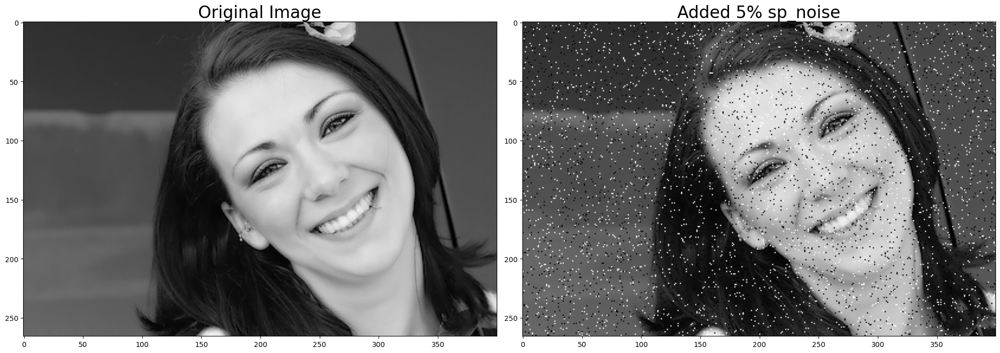

In [3]:
plt.figure(figsize=(20,20))                        # Set the size of figures

plt.subplot(1,2,1)                                 # Set up a 1x2 layout grid
plt.title('Original Image',fontsize=24)            # Title the figure and adjust the font size of title
img = plt.imread('face.png')                       # Read the image file 'face.png' and assigns it to the variable 'img'
plt.imshow(img)                                    # Display the image in the current subplot

plt.subplot(1,2,2)
plt.title('Added 5% sp_noise',fontsize=24) 
noise = sp_noise('face.png',0.05)                   # Add salt and pepper noise with a percentage of 0.05 to the original image 'face.png' and assigns the resulting noisy image to the variable 'noise'
plt.imshow(noise, cmap = 'gray')                    # Display the noisy image in the current subplot using the imshow function and a grayscale colormap

plt.tight_layout()                                  # Adjust the spacing between the subplots to prevent overlap

Now we can get a noisy image using the `sp_noise` function, let's try to remove the noise using the mean filter and the median filter.

## Part 2. Mean Filter

**Mean filter** is commonly used to reduce noise and blur in an image. By taking the average of neighboring pixel values, it can help to smooth out small variations in intensity, resulting in a more uniform image. However, it can also cause a loss of sharpness in the image, so the window size used for the filter must be carefully chosen to balance noise reduction with preserving image details.

The mean filter is a simple sliding-window spatial filter that replaces the center value in the window with the average (mean) of all the pixel values in the window. The window, or kernel, is usually square but can be any shape. An example of mean filtering of a single $3\times 3$ window of values is shown below.

<div>

</div>

We can use numpy to compute this mean:

In [4]:
square = np.array([[0.6, 0.7, 0.4],
                   [0.7, 0.6, 0.1],
                   [0.5, 0.5, 0.0]])

sq_mean = np.mean(square)
print(sq_mean)

0.4555555555555555


Center value (previously $P[i,j]=0.6$) is replaced by the mean of all nine values ($0.4555555555555555$).

Let's try the mean filter first. Firstly, we should define a function to create the tool as `mean_filter`. The function `mean_filter(img, s)` that takes as its first argument a 2-dimensional numpy array `img` representing an image, and returns a numpy array obtained by applying to img the mean filter. The second argument of the function, `s` is the size of square of pixels used by the filter

The function first checks that the window size `s` is odd, because an even window size would create an asymmetrical kernel and could cause unexpected behavior. The `np.zeros` method then produces a new image filled with zeros that is a multiple of the window size (i.e., a pixels on each side) larger than the original image. The kernel can then be applied to pixels close to the edge of the original image by `.copy()`, first copying the old image into the middle of this new image. The function next goes through every pixel in the original image, excluding the edges, and replaces each one with the mean value of the pixels in its immediate vicinity within the kernel. The mean values are computed by `np.mean`.

In [5]:
def mean_filter(img,s):                      
    if s % 2 != 1:                            # Check if the window size is odd. 
        print("Please try an odd number.")    # If it is even, it prints a message to inform the user to try an odd number.
    
    n = s // 2                                # Calculate half of the window size, rounded down, to determine the distance 
                                              # from the central pixel to the edge of the kernel.
    
    r,c = img.shape                           # Extract the dimensions of the input image img.
    bigger = np.zeros((2*n+r,2*n+c))          # Create a new matrix bigger with zeros that is larger than the original image 
                                              # by a margin of a pixels on each side.
    bigger[n:(r+n),n:(c+n)] = img.copy()      # The original image is then copied into the center of this new image, which 
                                              # allows the kernel to be applied to pixels near the edge of the original image    
    
    for i in range(n,r+n):                    # Iterate over each pixel in the original image, excluding the outer edges
        for j in range(n,c+n):
            new = bigger[i-n:i+n+1,j-n:j+n+1]  
            mean = np.mean(new)               # Compute the mean value
            img[i-n,j-n] = mean               # Replace it with the mean value of the surrounding pixels within the kernel
            
    return img                                # Return the modified image with mean filter applied

Create a figure with three subplots that demonstrate the application of a `mean_filter` to an image `boston.png` with salt and pepper noise. 

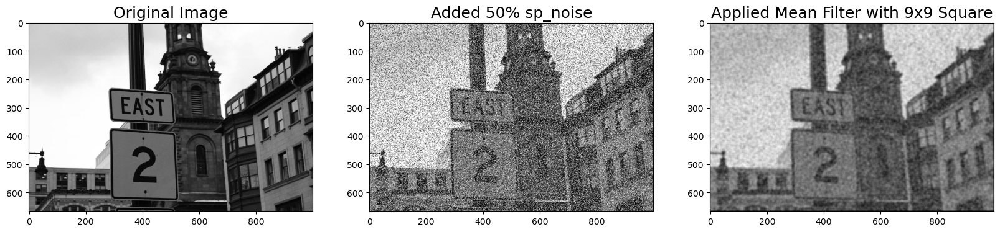

In [6]:
plt.figure(figsize=(20,20))                                  # Specify the size using figure function

plt.subplot(1,3,1)                                           # Set up a 1x3 layout grid
plt.title('Original Image',fontsize=18)                      # Title the first subplot and adjust the font size of the title
img = plt.imread('boston.png')                               # Load an image from a file using plt.imread()
plt.imshow(img)                                              # Display the image using plt.imshow()

plt.subplot(1,3,2)                                           # Title the second subplot and adjust the font size of the title
plt.title('Added 50% sp_noise',fontsize=18)                  # Generate the salt and pepper noise on the same image using the
noise = sp_noise('boston.png',0.5)                           # `sp_noise` function. 
plt.imshow(noise, cmap = 'gray')                             # The noisy image is displayed using plt.imshow().

plt.subplot(1,3,3)
plt.title('Applied Mean Filter with 9x9 Square',fontsize=18) 
mf = mean_filter(noise.copy(),9)                             # Apply the mean filter with a window size of 9 to the noisy image
plt.imshow(mf, cmap = 'gray')                                # The filtered image is displayed using plt.imshow().

By comparing these images, we can see that the graininess of filtered (third) images is less than that of noisy (middle) images, and the filter also enhances the fuzzy sense.

## Part 3. Median Filter

The **median filter** is similar to the mean filter, but instead of using the mean of values of pixels in a square it takes the *median* of these values.

Use the same square of pixels as above matrix. Using numpy we obtain:

In [7]:
square = np.array([[0.6, 0.7, 0.4],
                   [0.7, 0.6, 0.1],
                   [0.5, 0.5, 0.0]])

sq_median = np.median(square)
print(sq_median)

0.5


Center value (previously $P[i,j]=0.6$) is replaced by the median of all nine values ($0.5$).

Same idea of defining the `mean_filter` function. Replace the `np.mean` with `np.median`.

In [8]:
def median_filter(img,s):                     # Same idea of defining the `mean_filter` function.     
    if s % 2 != 1:                            # Check if the window size is odd. 
        print("Please try an odd number.")    # If it is even, it prints a message to inform the user to try an odd number.
        
    n = s // 2                                # Calculate half of the window size, rounded down, to determine the distance             
    
    r,c = img.shape                           # Extract the dimensions of the input image img.
    bigger = np.zeros((2*n+r,2*n+c))          # Create a new matrix bigger with zeros that is larger than the original image 
                                              # by a margin of a pixels on each side.
    bigger[n:(r+n),n:(c+n)] = img.copy()      # The original image is then copied into the center of this new image, which 
                                              # allows the kernel to be applied to pixels near the edge of the original image
        
    for i in range(n,r+n):                    # Iterate over each pixel in the original image, excluding the outer edges
        for j in range(n,c+n):
            new = bigger[i-n:i+n+1,j-n:j+n+1]
            median = np.median(new)           # Compute the median value
            img[i-n,j-n] = median             # Replace it with the median value of 
                                              # the surrounding pixels within the kernel
    return img                                # Return the modified image with median filter applied

Create a figure with three subplots that demonstrate the application of a `median_filter` to an image `boston.png` with salt and pepper noise. 

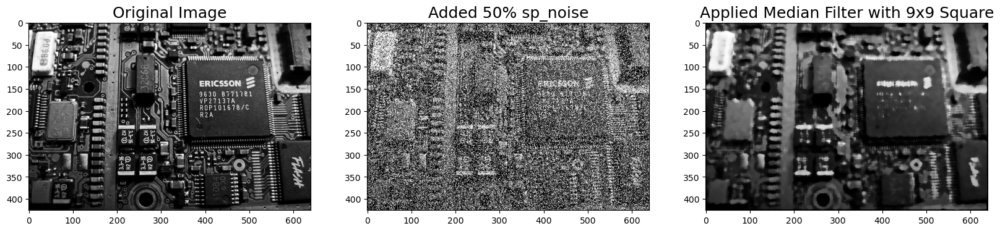

In [9]:
plt.figure(figsize=(20,20))                                    # Specify the size using figure function

plt.subplot(1,3,1)                                             # Set up a 1x3 layout grid
plt.title('Original Image',fontsize=18)
img = plt.imread('circuit.png')                                # Load an image from a file using plt.imread()
plt.imshow(img)                                                # Display the image using plt.imshow() 

plt.subplot(1,3,2)
plt.title('Added 50% sp_noise',fontsize=18)
noise = sp_noise('circuit.png',0.5)                            # Generate the salt and pepper noise on the same image using the
plt.imshow(noise, cmap = 'gray')                               # image using the `sp_noise` function. 

plt.subplot(1,3,3)
plt.title('Applied Median Filter with 9x9 Square',fontsize=18)
mdf = median_filter(noise.copy(),9)                            # Apply the mean filter with a window size of 9 to the noisy image
plt.imshow(mdf, cmap = 'gray')

We can see that after the median filter was applied, the graininess of the noise points was eliminated a lot, so we can't see noise points without looking carefully. But at the same time the blur is intense, like a vision from a person who is short-sighted.

## Part 4. Discussion

### Which filter, mean or median works better for reducing noise and why?

Read an image `motorbike.png`, then we get a noisy image by `sp_noise`, adding `50%` noise to it. Then, on both sides of the noisy image, display two filtered images that are applied `mean_filter` and `median_filter` respectively but using the same window size of `s=7`.

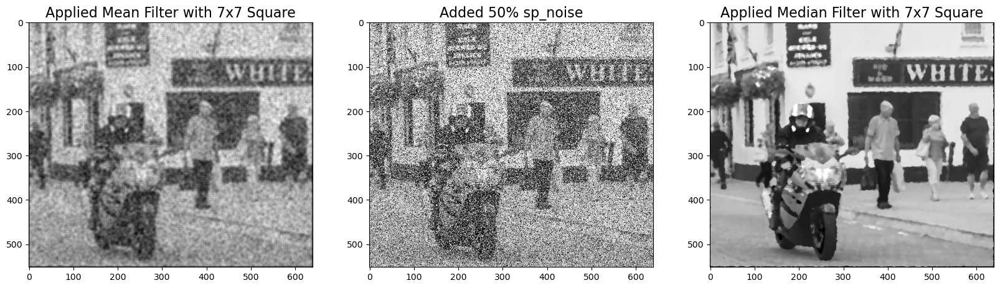

In [10]:
plt.figure(figsize=(20,20))                                    # Specify the size using figure function

plt.subplot(1,3,2)                                             # Set up a 1x3 layout grid
plt.title('Added 50% sp_noise',fontsize=16)                    # Title the second subplot for knowing the middle image is the original
noise = sp_noise('motorbike.png',0.5)                          # Generate the salt and pepper noise on the motorbike image in 50%
plt.imshow(noise, cmap = 'gray')

plt.subplot(1,3,1)
plt.title('Applied Mean Filter with 7x7 Square',fontsize=16)
mf = mean_filter(noise.copy(),7)                               # Apply the mean filter with a window size of 7 to the noisy image
plt.imshow(mf, cmap = 'gray')

plt.subplot(1,3,3)
plt.title('Applied Median Filter with 7x7 Square',fontsize=16)
mdf = median_filter(noise.copy(),7)                            # Apply the median filter with a window size of 7 to the noisy image
plt.imshow(mdf, cmap = 'gray')

* In my view, the median filter is better. The mean filter takes a linear approach and averages the pixel values throughout the entire window, so the median filter is preferable. The reason is that some pixel values are so extreme, the mean filter itself has limitations because the image is denoised and the details are lost, causing the image to become blurry. The median filter performs better because it chooses the list's middle value, which is unaffected by the extreme values.

### What happens as the value of `s` in these filters is increased?

Read an image `hamburg.png`, then we get a noisy image by `sp_noise`, adding `50%` noise to it. 
We create two figures of $4\times 4$ subplots to display the filter images using different `s` values of two filter tools. The influence of `s` value on noise reduction is observed by changing the value of `s`.

Display the `hamburg.png` image with `50%` salt and pepper noise, and three mean-filterd images with `s=5,9,13`.

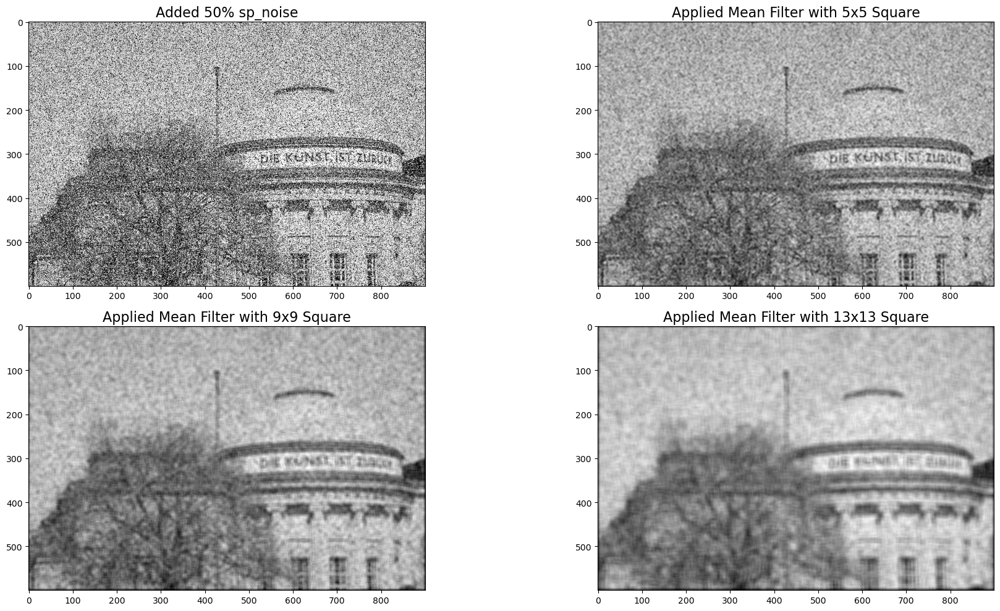

In [11]:
# Create a figure with 4 subplots of the noisy image and three images filtered by the mean filter as the 's' value increases

plt.figure(figsize=(20,10))                                    

plt.subplot(2,2,1)
plt.title('Added 50% sp_noise',fontsize=16)
noise = sp_noise('hamburg.png',0.5)
plt.imshow(noise, cmap = 'gray')

plt.subplot(2,2,2)
plt.title('Applied Mean Filter with 5x5 Square',fontsize=16)
mf = mean_filter(noise.copy(),5)
plt.imshow(mf, cmap = 'gray')

plt.subplot(2,2,3)
plt.title('Applied Mean Filter with 9x9 Square',fontsize=16)
mf = mean_filter(noise.copy(),9)
plt.imshow(mf, cmap = 'gray')

plt.subplot(2,2,4)
plt.title('Applied Mean Filter with 13x13 Square',fontsize=16)
mf = mean_filter(noise.copy(),13)
plt.imshow(mf, cmap = 'gray')

plt.tight_layout()

Display the `hamburg.png` image with `50%` salt and pepper noise, and three median-filterd images with `s=5,9,13`.

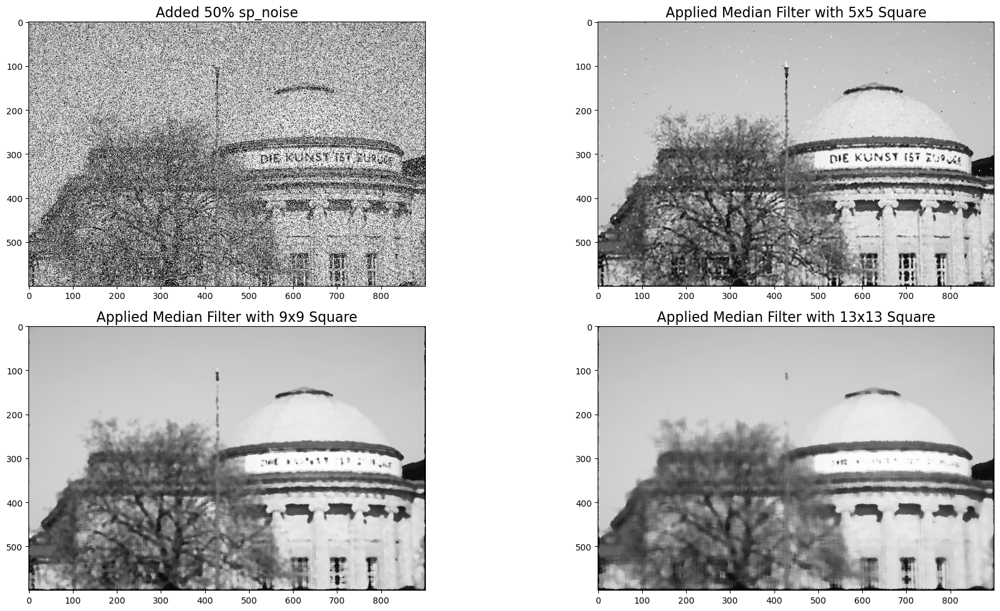

In [12]:
# Create a figure with 4 subplots of the noisy image and three images filtered by the median filter as the 's' value increases.

plt.figure(figsize=(20,10))

plt.subplot(2,2,1)
plt.title('Added 50% sp_noise',fontsize=16)
noise = sp_noise('hamburg.png',0.5)
plt.imshow(noise, cmap = 'gray')

plt.subplot(2,2,2)
plt.title('Applied Median Filter with 5x5 Square',fontsize=16)
mdf = median_filter(noise.copy(),5)
plt.imshow(mdf, cmap = 'gray')

plt.subplot(2,2,3)
plt.title('Applied Median Filter with 9x9 Square',fontsize=16)
mdf = median_filter(noise.copy(),9)
plt.imshow(mdf, cmap = 'gray')

plt.subplot(2,2,4)
plt.title('Applied Median Filter with 13x13 Square',fontsize=16)
mdf = median_filter(noise.copy(),13)
plt.imshow(mdf, cmap = 'gray')

plt.tight_layout()

* For both filter tools, the noise will be decreased. However, the sharpness of the images will be decreased as well.

### What happens as the level of noise in an image is increased?

Read the image `hamburg.png`, then we add different percentages of noise by `sp_noise`. `noise=0.3,0.6,0.9` are chosen.

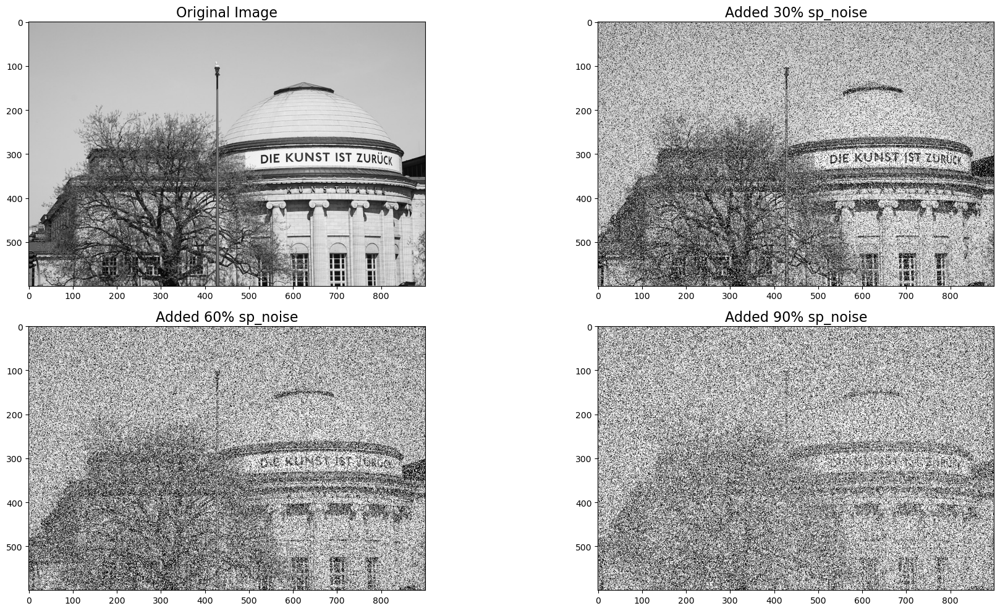

In [13]:
# Create a figure with 4 subplots of the original image and three images with 30%, 60%, 90% salt and pepper noise.

plt.figure(figsize=(20,10))

plt.subplot(2,2,1)
plt.title('Original Image',fontsize=16)
img = plt.imread('hamburg.png')
plt.imshow(img)

plt.subplot(2,2,2)
plt.title('Added 30% sp_noise',fontsize=16)
noise3 = sp_noise('hamburg.png',0.3)
plt.imshow(noise3, cmap = 'gray')

plt.subplot(2,2,3)
plt.title('Added 60% sp_noise',fontsize=16)
noise6 = sp_noise('hamburg.png',0.6)
plt.imshow(noise6, cmap = 'gray')

plt.subplot(2,2,4)
plt.title('Added 90% sp_noise',fontsize=16)
noise9 = sp_noise('hamburg.png',0.9)
plt.imshow(noise9, cmap = 'gray')

plt.tight_layout()

* As the noise increases, the image is occupied by salt spots and pepper spots. The higher the percentage of noise, the less clear the image, it results in only the outline of the color , we can not see the details.

### You can also include ideas how the process of noise reduction could be improved.

* Based on the previous discussion, we can remove the extreme values on the basis of the mean filter, and then create a new filter using a similar method.

## Part 5. New filter

In this part, we will use our own formula to denoise the image. First, we will design a function to remove extreme values as much as possible. This formula uses `np.mean()` and `np.std()` to remove outliers from NumPy array.

This code below defines a function called `new_formula` that takes in an array `arr` as its argument.

In [14]:
def new_formula(arr):
    mean = np.mean(arr)       # Calculate the mean of the input array 
    std_dev = np.std(arr)     # Calculate the standard deviation of the input array 
    
    zero_based  = abs(arr - mean) # Calculate the absolute difference between each element
                                  # of the input array and the mean, 
                                  # and stores the result in a new variable called zero_based.
    
    max_deviations = 1            # Set the maximum number of standard deviations from the mean
                                  # that we consider to be "extreme" values. It's set to 1.
    
    no_extreme_values = arr[zero_based < max_deviations * std_dev]
    # Create a new array called no_extreme_values that contains only the values from the input 
    # array that are not considered to be "extreme" based on the maximum number of standard deviations from the mean.
    
    new_arr = np.mean(no_extreme_values) # Calculate the mean of the values in the no_extreme_values array 
                                         # and stores the result in a new variable called new_arr.
    return new_arr  # Return the calculated mean value from the new_arr variable as the output of the new_formula function.

Similar idea of defining the `mean_filter` function. Replace the `np.mean` with our formula `new_formula`.

In [15]:
def new_filter(img,s):
    n = s // 2
    r,c = img.shape
    
    bigger = np.zeros((2*n+r,2*n+c))
    bigger[n:(r+n),n:(c+n)] = img.copy()
    
    for i in range(n,r+n):
        for j in range(n,c+n):
            new = bigger[i-n:i+n+1,j-n:j+n+1]
            new_arr = new_formula(new)        # Change mean formula into the new formula
            
            img[i-n,j-n] = new_arr
            
    return img

Create a figure with three subplots that demonstrate the application of a `new_filter` to an image `circuit.png` with `50%` salt and pepper noise.

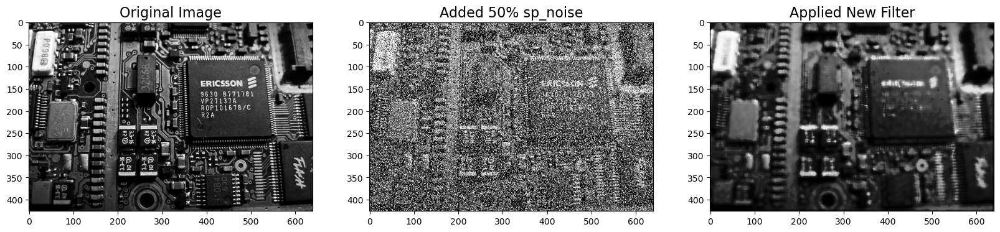

In [16]:
# Create a figure with 3 subplots of the original image, 50% sp_noise image 
# and an image by the new filter.

plt.figure(figsize=(20,20))

plt.subplot(1,3,1)
plt.title('Original Image',fontsize=16)
img = plt.imread('circuit.png')
plt.imshow(img)

plt.subplot(1,3,2)
plt.title('Added 50% sp_noise',fontsize=16)
noise = sp_noise('circuit.png',0.5)
plt.imshow(noise, cmap = 'gray')

plt.subplot(1,3,3)
plt.title('Applied New Filter',fontsize=16)
nf = new_filter(noise.copy(),9)
plt.imshow(nf, cmap = 'gray')

## Extra Credit

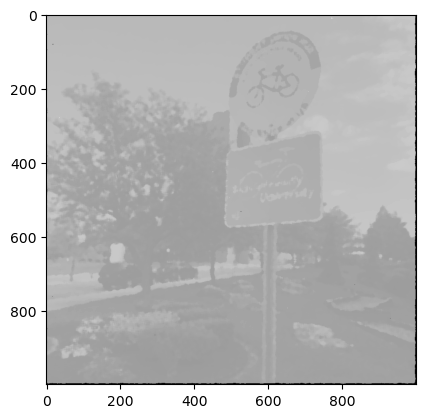

In [17]:
ec1 = plt.imread('ub_noisy1.png')
ec1_gray = ec1[:,:,0]
mdf = median_filter(ec1_gray,9)
plt.imshow(mdf, cmap = 'gray')

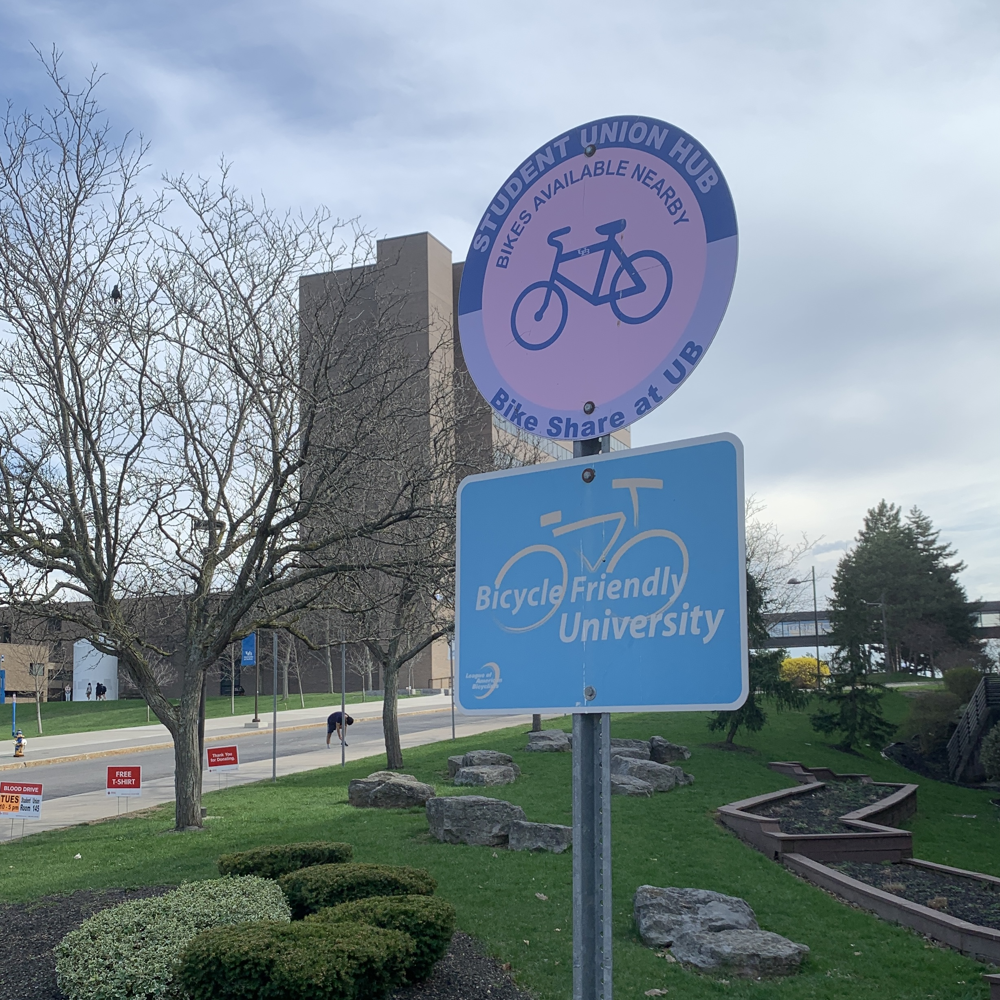

In [18]:
from IPython.display import Image
Image("bike.JPG")

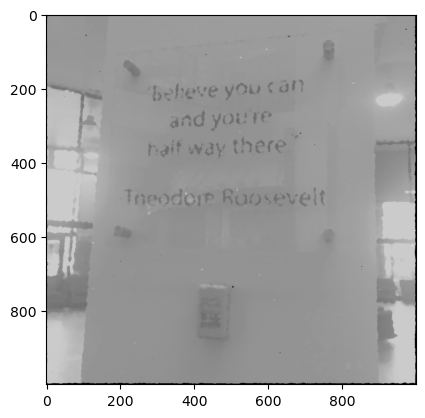

In [19]:
ec2 = plt.imread('ub_noisy2.png')
ec2_gray = ec2[:,:,0]
mdf = median_filter(ec2_gray,9)
plt.imshow(mdf, cmap = 'gray')

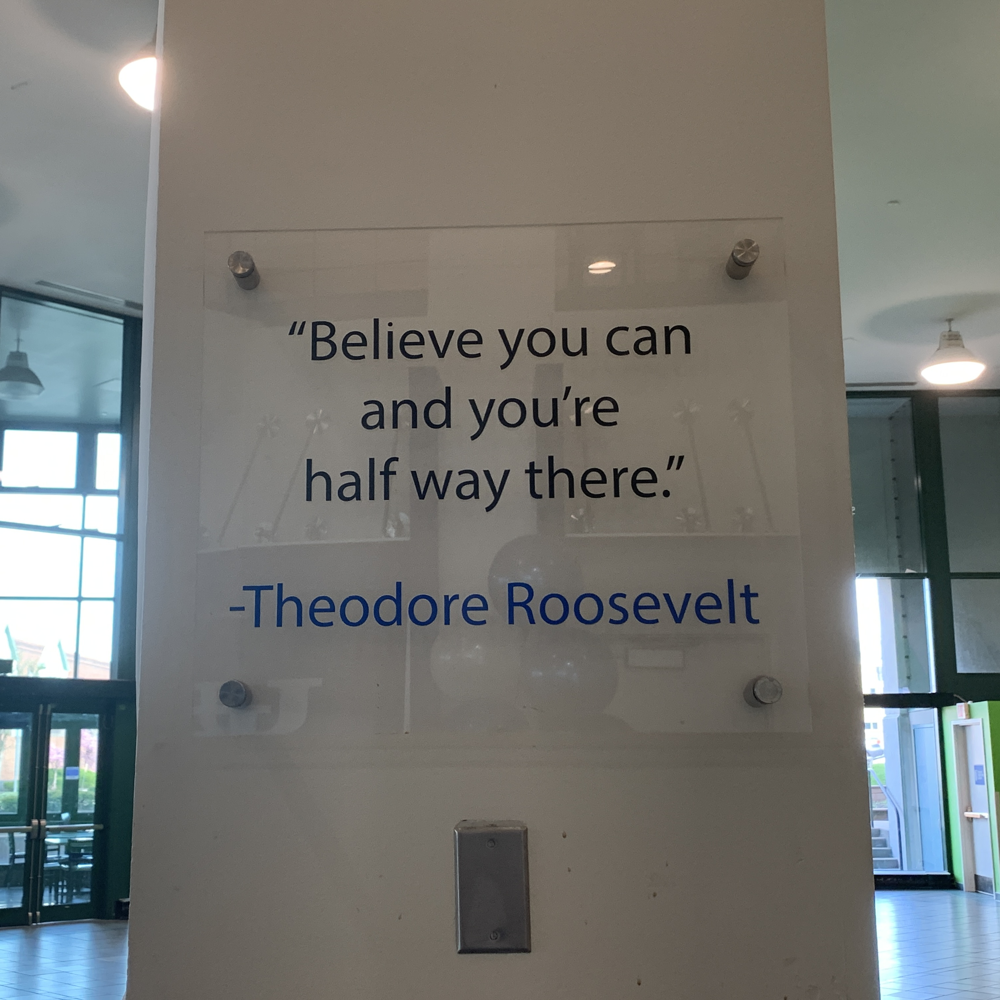

In [20]:
Image("Roosevelt.JPG")

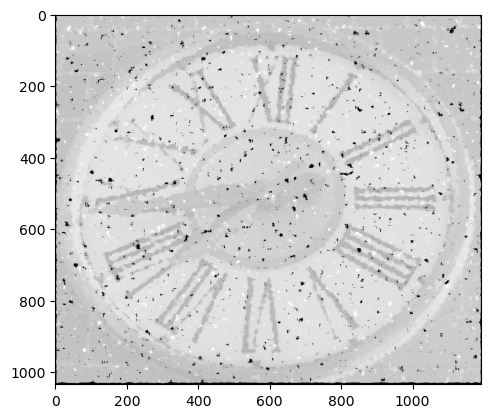

In [21]:
ec3 = plt.imread('ub_noisy3.png')
ec3_gray = ec3[:,:,0]
mdf = median_filter(ec3_gray,11)
plt.imshow(mdf, cmap = 'gray')

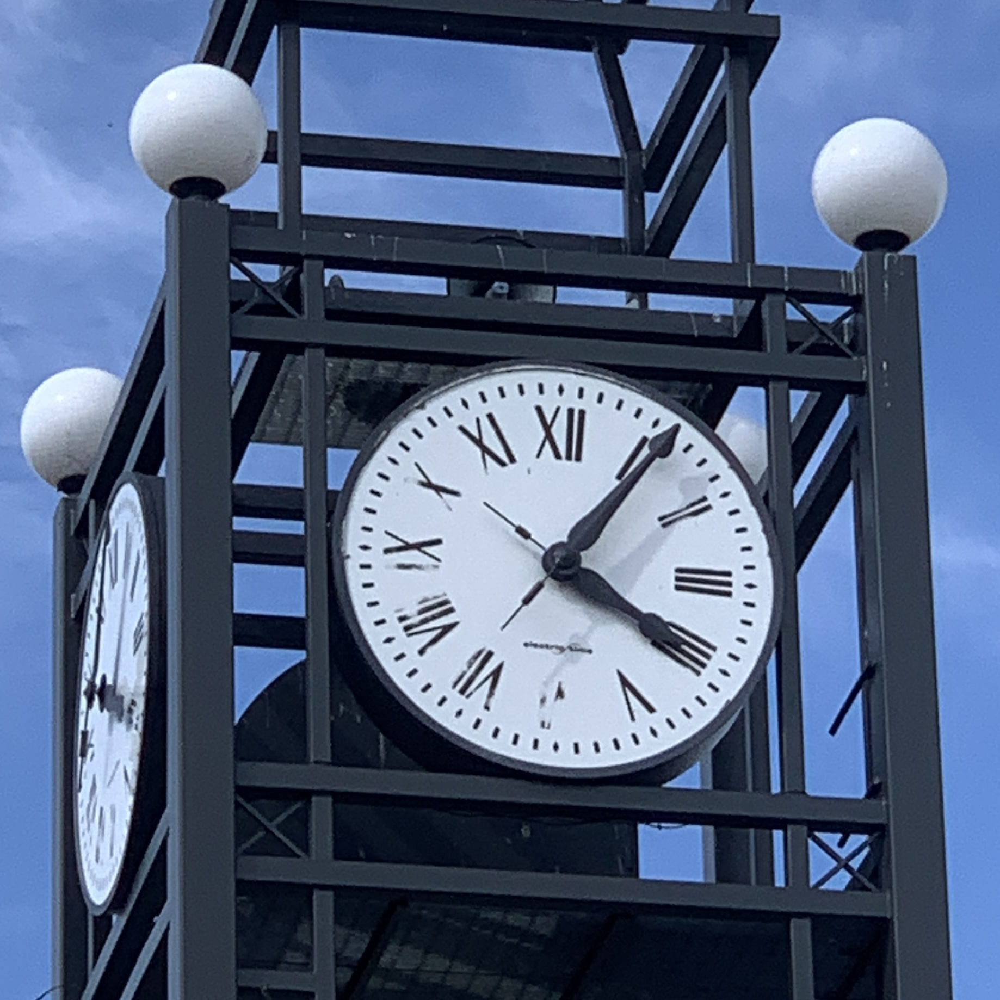

In [22]:
Image("belfry.JPG")

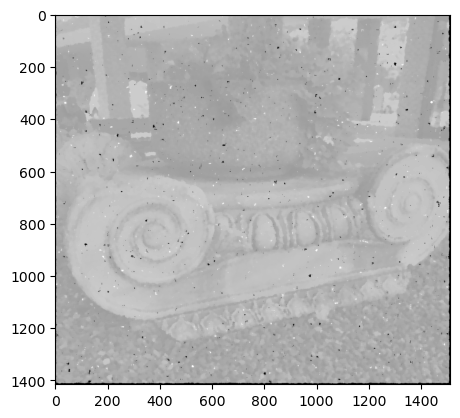

In [23]:
ec4 = plt.imread('ub_noisy4.png')
ec4_gray = ec4[:,:,0]
mdf = median_filter(ec4_gray,11)
plt.imshow(mdf, cmap = 'gray')

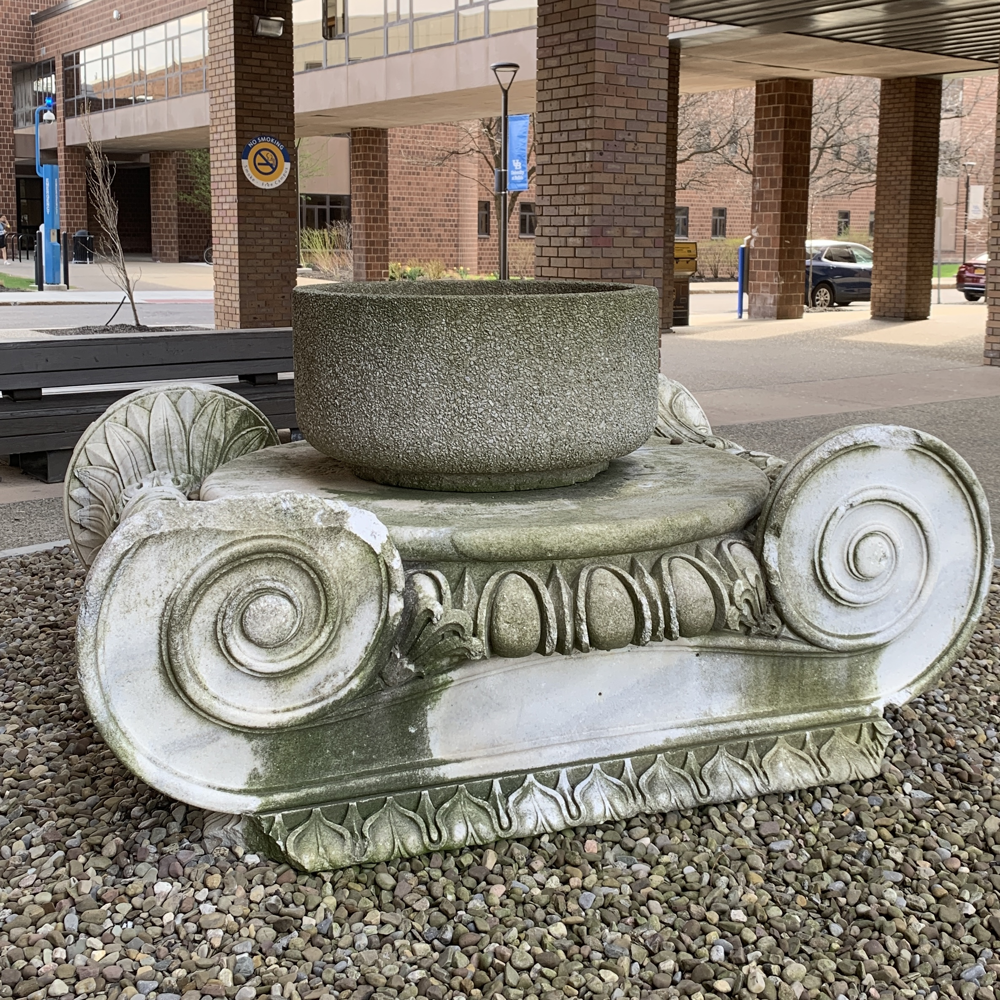

In [24]:
Image("flower bed.JPG")

## Reference


[Image noise](https://en.wikipedia.org/wiki/Image_noise)

[mean filter](https://www.markschulze.net/java/meanmed.html)

[median filter](https://jllottes.github.io/Projects/image_denoising/image_denoising.html)

[Remove extreme values](https://blog.finxter.com/how-to-find-outliers-in-python-easily/)